<h3>Importing required modules</h3>


In [4]:
import tensorflow as tf
from tensorflow import keras
from keras.preprocessing.image import ImageDataGenerator
from keras.utils import array_to_img, img_to_array, load_img


In [5]:
from sklearn.model_selection import train_test_split
from tensorflow.keras.optimizers import Adam
import skimage.io as ski
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

Loading the Dataframes

In [6]:
train_df1= pd.read_csv("train.csv")
test_df=pd.read_csv("test.csv")

In [6]:
#Split the data into training and validation dataset
train_df, val_df= train_test_split(train_df1, test_size=0.2, random_state=0)

In [52]:
def mask2rle(img):
    #https://www.kaggle.com/code/paulorzp/rle-functions-run-lenght-encode-decode
    #img: numpy array, 1 - mask, 0 - background
    #Returns run length as string formated
    pixels= img.T.flatten()
    pixels = np.concatenate([[0], pixels, [0]])
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 1
    runs[1::2] -= runs[::2]
    return ' '.join(str(x) for x in runs)

def rle2mask(mask_rle, shape=(256,256)):
    #mask_rle: run-length as string formated (start length)
    #shape: (width,height) of array to return 
    #Returns numpy array, 1 - mask, 0 - background
    s = mask_rle.split()
    starts, lengths = [np.asarray(x, dtype=int) for x in (s[0:][::2], s[1:][::2])]
    starts -= 1
    ends = starts + lengths
    img = np.zeros(shape[0]*shape[1], dtype=np.uint8)
    for lo, hi in zip(starts, ends):
        img[lo:hi] = 1
    return img.reshape(shape).T


<h3>Loading/Reading Image Date</h3>


In [9]:
#load/read images
train_data=[]
train_mask=[]
val_data=[]
val_mask=[]

for i,row in train_df.iterrows():
    image=ski.imread(f'train/train/{row["id"]}')[:,:256,:3]
    image=image/255
    if (row['segmentation_pred']!="Healthy"):
        mask=rle2mask(row['segmentation_pred'])
    else:
        mask=np.zeros((256,256))
    mask.reshape((256,256,-1))
    train_data.append(image)
    train_mask.append(mask)
    
for i,row in val_df.iterrows():
    image=ski.imread(f'train/train/{row["id"]}')[:,:256,:3]
    image=image/255
    if (row['segmentation_pred']!="Healthy"):
        mask=rle2mask(row['segmentation_pred'])
    else:
        mask=np.zeros((256,256))
    mask.reshape((256,256,-1))
    val_data.append(image)
    val_mask.append(mask)    

In [10]:

train_dataset = tf.data.Dataset.from_tensor_slices((train_data,train_mask))
val_dataset =tf.data.Dataset.from_tensor_slices((val_data,val_mask))


In [11]:
BATCH_SIZE = 16
train_dataset = train_dataset.batch(BATCH_SIZE)
val_dataset = val_dataset.batch(BATCH_SIZE)

<h3>UNET Model</h3>


In [13]:
def conv_block(inputs,n_filters):
    x=tf.keras.layers.Conv2D(n_filters,3,padding='same')(inputs)
    x=tf.keras.layers.BatchNormalization()(x)
    x=tf.keras.layers.Activation('relu')(x)
    
    x=tf.keras.layers.Conv2D(n_filters,3,padding='same')(x)
    x=tf.keras.layers.BatchNormalization()(x)
    x=tf.keras.layers.Activation('relu')(x)
    
    return x

def encoder_block(inputs,n_filters):
    x=conv_block(inputs,n_filters)
    p=tf.keras.layers.MaxPool2D((2,2))(x)
    return x,p

def decoder_block(inputs,skip,n_filters):
    x=tf.keras.layers.Conv2DTranspose(n_filters,(2,2),strides=2,padding='same')(inputs)
    x=tf.keras.layers.Concatenate()([x,skip])
    x=conv_block(x,n_filters)
    return x

def unet_model(input_shape):
    inputs=tf.keras.Input(input_shape)
    #Endcocer blocks
    e1,p1= encoder_block(inputs,64)
    e2,p2= encoder_block(p1,128)
    e3,p3= encoder_block(p2,256)
    e4,p4= encoder_block(p3,512)

    b1=conv_block(p4,1024)
    #decoder blocks
    d1=decoder_block(b1,e4,512)  #skip connections
    d2=decoder_block(d1,e3,256)
    d3=decoder_block(d2,e2,128)
    d4=decoder_block(d3,e1,64)

    outputs=tf.keras.layers.Conv2D(1,1,activation='sigmoid')(d4)
    
    model=tf.keras.models.Model(inputs,outputs,name="UNET")
    return model

In [14]:
model=unet_model((256,256,3))
model.summary()
model.compile(optimizer=Adam(0.0001),
                  loss=tf.keras.losses.BinaryCrossentropy(),
                metrics=['accuracy'])

Model: "UNET"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 256, 256, 64  1792        ['input_2[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 256, 256, 64  256        ['conv2d[0][0]']                 
 alization)                     )                                                              

<h3>Training the model</h3>


In [15]:
#Train the model
history =model.fit(
        train_dataset,
      validation_data=val_dataset,
      epochs=20,
        batch_size=16,
    )

Epoch 1/20
46/46 [==============================] - 183s 4s/step - loss: 0.4309 - accuracy: 0.8636 - val_loss: 0.6254 - val_accuracy: 0.9242
Epoch 2/20
46/46 [==============================] - 174s 4s/step - loss: 0.2831 - accuracy: 0.9198 - val_loss: 0.4656 - val_accuracy: 0.9242
Epoch 3/20
46/46 [==============================] - 175s 4s/step - loss: 0.2404 - accuracy: 0.9246 - val_loss: 0.3790 - val_accuracy: 0.9243
Epoch 4/20
46/46 [==============================] - 173s 4s/step - loss: 0.2196 - accuracy: 0.9278 - val_loss: 0.3794 - val_accuracy: 0.8866
Epoch 5/20
46/46 [==============================] - 175s 4s/step - loss: 0.2061 - accuracy: 0.9310 - val_loss: 0.3718 - val_accuracy: 0.8359
Epoch 6/20
46/46 [==============================] - 172s 4s/step - loss: 0.1980 - accuracy: 0.9331 - val_loss: 0.5193 - val_accuracy: 0.6932
Epoch 7/20
46/46 [==============================] - 173s 4s/step - loss: 0.1938 - accuracy: 0.9326 - val_loss: 0.5246 - val_accuracy: 0.6996
Epoch 8/20
46

In [32]:
for image_batch, labels_batch in train_dataset:
    print(image_batch.shape)
    print(labels_batch.shape)
    break

(16, 256, 256, 3)
(16, 256, 256)


<h3>Training Performence plots</h3>


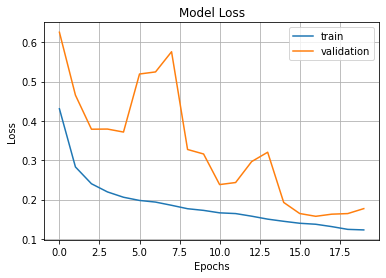

In [23]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.grid()
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epochs')
plt.legend(['train', 'validation'])
plt.show()

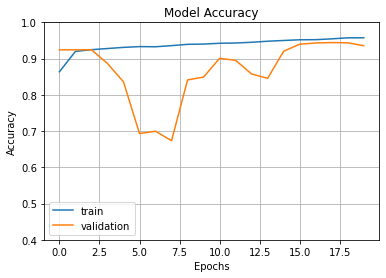

In [24]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.axis(ymin=0.4,ymax=1)
plt.grid()
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epochs')
plt.legend(['train', 'validation'])
plt.show()
     

<h3>Loading the test data and segmenting</h3>

In [8]:
test_df=pd.read_csv("test.csv")
test_data=[]
for i,row in test_df.iterrows():
    image=ski.imread(f'test/test/{row["id"]}')[:,:256,:3]
    image=image/255
    test_data.append(image)

In [9]:
test_data=np.expand_dims(test_data, axis=0)
test_dataset = tf.data.Dataset.from_tensor_slices(test_data)

In [10]:
predictions=model.predict(test_dataset)

1/1 [==============================] - 26s 26s/step


In [11]:
predictions=tf.round(predictions)

/apps/codes/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


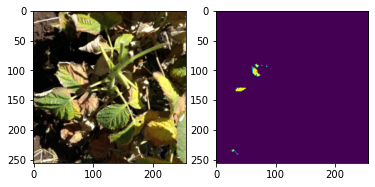

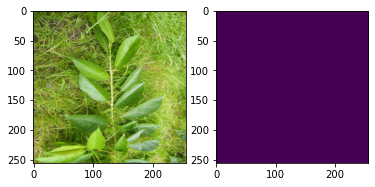

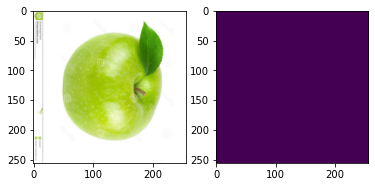

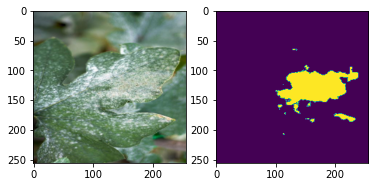

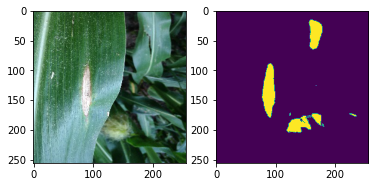

...

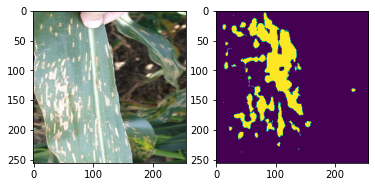

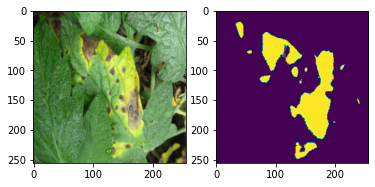

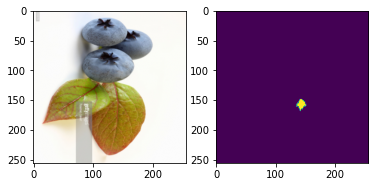

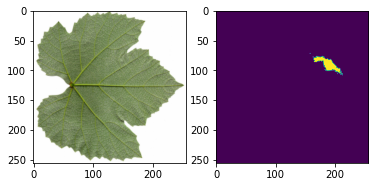

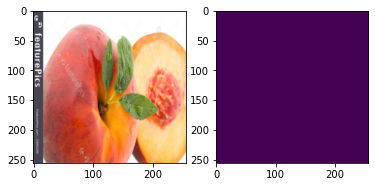

In [69]:
for i in range(len(predictions)):
    fig, axs =plt.subplots(1,2)
    axs[1].imshow(predictions[i])
    axs[0].imshow(test_data[0][i])

<h3>Save the model</h3>


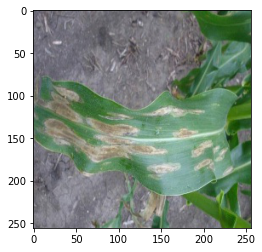

In [13]:
# model.save("unet_model.h5")
# model = tf.keras.models.load_model('unet_model.h5')

Save predictions to file

In [55]:
submisssion= pd.read_csv("sample_submission.csv")

In [56]:
submisssion

,id,binary_pred,segmentation_pred
0,Img_919.png,0.0,6892 1 7147 3 7402 1 7404 2 7658 3 7915 2 8430...
1,Img_920.png,0.0,Healthy
2,Img_921.png,0.0,Healthy
3,Img_922.png,1.0,25735 3 25991 2 26248 3 26252 1 26254 1 26503 ...
4,Img_923.png,1.0,19854 1 19856 5 20101 20 20350 1 20352 27 2059...
...,...,...,...
389,Img_1308.png,1.0,2843 5 3097 8 3227 1 3353 9 3422 1 3609 9 3675...
390,Img_1309.png,1.0,8472 3 8726 8 8982 11 9238 14 9493 18 9749 21 ...
391,Img_1310.png,0.0,34462 1 34464 1 34466 1 34719 1 34721 1 34972 ...
392,Img_1311.png,1.0,40265 1 41551 1 41809 1 41811 1 42064 5 42070 ...


In [60]:
seg_list=[]
for i in range(len(predictions)):
    if(predictions[i].numpy().max()==0):
        seg='Healthy'
    else:
        seg=predictions[i].numpy()
        seg=np.stack(seg*3,axis=1)
        seg=mask2rle(seg)
    seg_list.append(seg)

In [61]:
submisssion['segmentation_pred']=seg_list

In [62]:
submisssion.to_csv('sample_submission.csv',index=False)

<h3>End</h3>
